In [ ]:
import pandas as pd

# Load the dataset to perform EDA
data = pd.read_csv('undersampled_data.csv')


data.head()

,race_color,age_group,gender,pregnant,education_level,occupation_type,treated_previously,case_type,clinical_form1,classification,...,treatment_institution,initial_treatment_scheme,current_scheme,treatment_type,number_primary_doses,number_secondary_doses,age,histopathological_exam,other_immunological_test,current_status
0,Pardo,20_29,M,N,De 1 a 3 anos,Outra,0.0,Novo,Pul,P+E,...,N,RHZ,N,Auto-Administrado,0.0,0.0,26.0,N/realiz,N,Abandono
1,Pardo,20_29,F,N,De 4 a 7 anos,Dona de Casa,0.0,Novo,Pul,Pul,...,N,RHZ,N,Auto-Administrado,0.0,0.0,25.0,N/realiz,N,Abandono
2,Branco,30_39,M,N,De 4 a 7 anos,Desempregado,0.0,Recidiva,Pul,Pul,...,N,RHZ,N,Supervisionado,27.0,0.0,38.0,N/realiz,N,Abandono
3,Branco,20_29,M,N,Unknown,Outra,0.0,Novo,Pul,P+E,...,NaN,RHZ,N,Auto-Administrado,0.0,0.0,27.0,N/realiz,N,Abandono
4,Branco,40_49,M,N,De 4 a 7 anos,Outra,0.0,Novo,Pul,Pul,...,NaN,RHZ,N,Supervisionado,14.0,58.0,40.0,Sugestivo TB,N,Abandono


In [ ]:
# Initial analysis: dataset shape, data types, and missing values
data_shape = data.shape
data_types = data.dtypes
missing_values = data.isnull().sum()

# Display the initial findings
data_shape, data_types, missing_values

((20560, 38),
 race_color                   object
 age_group                    object
 gender                       object
 pregnant                     object
 education_level              object
 occupation_type              object
 treated_previously          float64
 case_type                    object
 clinical_form1               object
 classification               object
 discovery_method             object
 bacilloscopy                 object
 other_bacilloscopy           object
 culture_exam                 object
 other_culture_exam           object
 x_ray                        object
 other_x_ray                  object
 necropsy                     object
 hiv_status                   object
 aids                         object
 diabetes                     object
 alcoholism                   object
 mental_condition             object
 drug_addiction               object
 smoking_habit                object
 total_communications        float64
 exposed_communication  

In [ ]:
# Descriptive statistics for numerical columns
numerical_summary = data.describe()

# Frequency counts for a subset of categorical columns to get an overview of distributions
categorical_columns = ['race_color', 'age_group', 'gender', 'pregnant', 'education_level', 'occupation_type',
                       'case_type', 'clinical_form1', 'classification', 'discovery_method']
categorical_summary = {col: data[col].value_counts() for col in categorical_columns}

# Display results to the user
numerical_summary, categorical_summary

(       treated_previously  total_communications  exposed_communication  \
 count        20560.000000          20560.000000           20560.000000   
 mean             0.158220              2.730545               1.704232   
 std              1.962367              4.483602               3.572180   
 min              0.000000              0.000000               0.000000   
 25%              0.000000              0.000000               0.000000   
 50%              0.000000              2.000000               0.000000   
 75%              0.000000              4.000000               3.000000   
 max             60.000000            300.000000             131.000000   
 
        communicated_disease  number_primary_doses  number_secondary_doses  \
 count          20560.000000          20560.000000            20560.000000   
 mean               0.081031             17.804329               25.826654   
 std                0.466130             21.152641               39.452653   
 min       

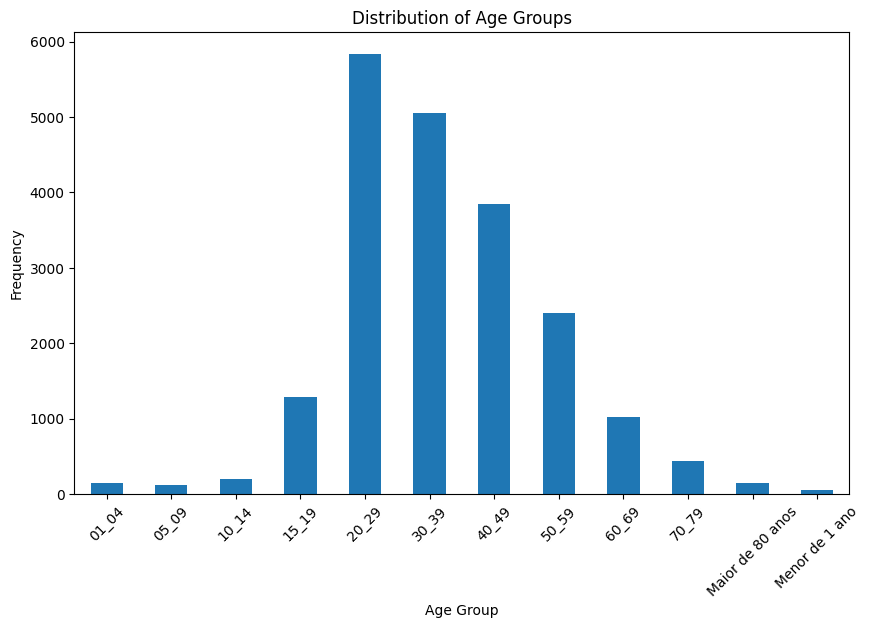

In [ ]:
import matplotlib.pyplot as plt

# Plot distribution of age groups
plt.figure(figsize=(10, 6))
data['age_group'].value_counts().sort_index().plot(kind='bar')
plt.title('Distribution of Age Groups')
plt.xlabel('Age Group')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.feature_selection import RFE
from sklearn.preprocessing import LabelEncoder

# Encode categorical variables
data_encoded = data.copy()
label_encoders = {}

# Encoding categorical features and the target column
for column in data_encoded.select_dtypes(include=['object']).columns:
    if column != 'current_status':  # Avoid encoding target here for now
        le = LabelEncoder()
        data_encoded[column] = le.fit_transform(data_encoded[column].astype(str))
        label_encoders[column] = le

# Encode the target column separately
target_encoder = LabelEncoder()
data_encoded['current_status'] = target_encoder.fit_transform(data_encoded['current_status'])

# Splitting data into features (X) and target (y)
X = data_encoded.drop(columns=['current_status'])
y = data_encoded['current_status']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize Decision Tree and RFE for feature selection
dt_classifier = DecisionTreeClassifier(random_state=42)
rfe = RFE(estimator=dt_classifier, n_features_to_select=10)

# Fit RFE on training data
rfe.fit(X_train, y_train)

# Get the selected features
selected_features = X.columns[rfe.support_]
selected_features

Index(['education_level', 'occupation_type', 'discovery_method', 'x_ray',
       'drug_addiction', 'total_communications', 'exposed_communication',
       'number_primary_doses', 'number_secondary_doses', 'age'],
      dtype='object')

In [ ]:
from sklearn.metrics import accuracy_score, classification_report
from sklearn.ensemble import RandomForestClassifier

# Subset the data to only include the selected features
X_train_selected = X_train[selected_features]
X_test_selected = X_test[selected_features]

# Initialize and train a Random Forest classifier
rf_classifier = RandomForestClassifier(random_state=42)
rf_classifier.fit(X_train_selected, y_train)

# Predictions on the test set
y_pred = rf_classifier.predict(X_test_selected)

# Model evaluation
accuracy = accuracy_score(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred, target_names=target_encoder.classes_)

accuracy, classification_rep

(0.7441634241245136,
 '              precision    recall  f1-score   support\n\n    Abandono       0.74      0.76      0.75      2067\n        Cura       0.75      0.73      0.74      2045\n\n    accuracy                           0.74      4112\n   macro avg       0.74      0.74      0.74      4112\nweighted avg       0.74      0.74      0.74      4112\n')

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import GradientBoostingClassifier

# Dictionary to hold models
models = {
    "Logistic Regression": LogisticRegression(max_iter=1000, random_state=42),
    "Support Vector Classifier": SVC(probability=True, random_state=42),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "Naive Bayes": GaussianNB(),
    "Gradient Boosting": GradientBoostingClassifier(random_state=42),
    "Decision Tree": DecisionTreeClassifier(random_state=42),
    "Random Forest": RandomForestClassifier(random_state=42)
}

# Train each model and evaluate on the test set
model_performance = {}

for model_name, model in models.items():
    model.fit(X_train_selected, y_train)
    y_pred = model.predict(X_test_selected)
    accuracy = accuracy_score(y_test, y_pred)
    report = classification_report(y_test, y_pred, target_names=target_encoder.classes_, output_dict=True)
    model_performance[model_name] = {"Accuracy": accuracy, "Classification Report": report}

# Display model performance results
model_performance

{'Logistic Regression': {'Accuracy': 0.7441634241245136,
  'Classification Report': {'Abandono': {'precision': 0.7072274397713353,
    'recall': 0.837929366231253,
    'f1-score': 0.7670504871567759,
    'support': 2067.0},
   'Cura': {'precision': 0.7985568250150331,
    'recall': 0.6493887530562347,
    'f1-score': 0.7162891046386192,
    'support': 2045.0},
   'accuracy': 0.7441634241245136,
   'macro avg': {'precision': 0.7528921323931842,
    'recall': 0.7436590596437438,
    'f1-score': 0.7416697958976975,
    'support': 4112.0},
   'weighted avg': {'precision': 0.7526478174034759,
    'recall': 0.7441634241245136,
    'f1-score': 0.7418055875338113,
    'support': 4112.0}}},
 'Support Vector Classifier': {'Accuracy': 0.7332198443579766,
  'Classification Report': {'Abandono': {'precision': 0.6856814701378254,
    'recall': 0.8664731494920174,
    'f1-score': 0.7655481940585596,
    'support': 2067.0},
   'Cura': {'precision': 0.816,
    'recall': 0.5985330073349633,
    'f1-scor

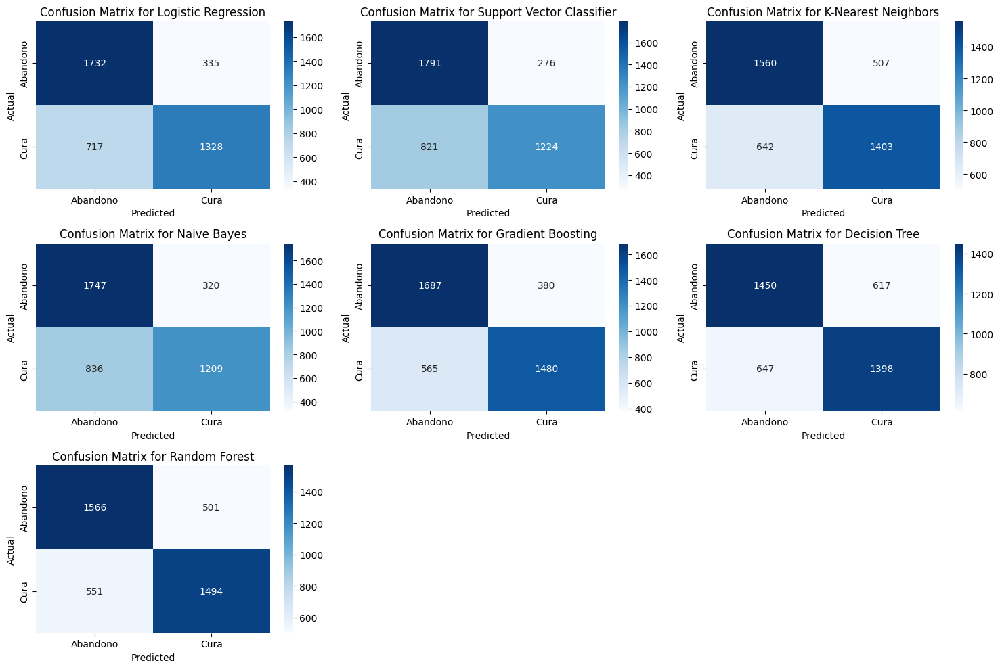

In [ ]:
# Import necessary libraries for plotting multiple confusion matrices and displaying a performance table
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Initialize dictionary to store confusion matrices
confusion_matrices = {}

# Generate confusion matrices for each model and calculate their performance metrics
for model_name, model in models.items():
    y_pred = model.predict(X_test_selected)
    confusion_matrices[model_name] = confusion_matrix(y_test, y_pred)

# Plot confusion matrices for each model
plt.figure(figsize=(15, 10))
for i, (model_name, cm) in enumerate(confusion_matrices.items(), start=1):
    plt.subplot(3, 3, i)
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=target_encoder.classes_, yticklabels=target_encoder.classes_)
    plt.title(f"Confusion Matrix for {model_name}")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")

plt.tight_layout()
plt.show()

# Create a performance summary table
import pandas as pd

# Extract accuracies and F1-scores for each model from the stored model performance
performance_table = pd.DataFrame({
    model_name: {
        "Accuracy": metrics["Accuracy"],
        "F1-Score (Abandono)": metrics["Classification Report"]["Abandono"]["f1-score"],
        "F1-Score (Cura)": metrics["Classification Report"]["Cura"]["f1-score"]
    } for model_name, metrics in model_performance.items()
}).T


In [ ]:
performance_table

,Accuracy,F1-Score (Abandono),F1-Score (Cura)
Logistic Regression,0.744163,0.767050,0.716289
Support Vector Classifier,0.733220,0.765548,0.690550
K-Nearest Neighbors,0.720574,0.730850,0.709482
Naive Bayes,0.718872,0.751398,0.676553
Gradient Boosting,0.770185,0.781199,0.758003
Decision Tree,0.692607,0.696446,0.688670
Random Forest,0.744163,0.748566,0.739604


<ipython-input-51-8e92b6a22b9f>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=feature_importance_df, x='Importance', y='Feature', palette='viridis')


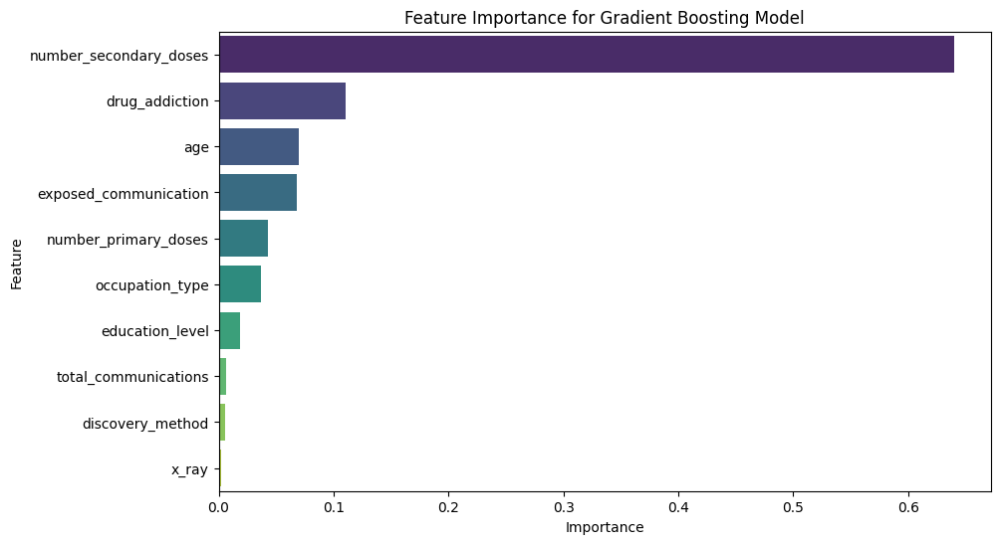

In [ ]:
# Extract feature importance from the Gradient Boosting model
gb_feature_importances = models["Gradient Boosting"].feature_importances_

# Create a DataFrame to display feature importance in descending order
feature_importance_df = pd.DataFrame({
    'Feature': selected_features,
    'Importance': gb_feature_importances
}).sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(10, 6))
sns.barplot(data=feature_importance_df, x='Importance', y='Feature', palette='viridis')
plt.title("Feature Importance for Gradient Boosting Model")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()

In [ ]:
# Adding 'treatment_type' and 'treatment_institution' to the selected columns
selected_columns = [
    'age_group', 'gender', 'race_color', 'education_level', 'occupation_type',
    'alcoholism', 'mental_condition', 'drug_addiction', 'smoking_habit',
    'total_communications', 'exposed_communication', 'communicated_disease',
    'treatment_type', 'treatment_institution'
]

# Subset data based on these selected columns and encode them for modeling
data_demographics_behavior = data[selected_columns + ['current_status']]

# Encode categorical variables
for column in data_demographics_behavior.select_dtypes(include=['object']).columns:
    if column != 'current_status':  # Exclude target column for now
        le = LabelEncoder()
        data_demographics_behavior[column] = le.fit_transform(data_demographics_behavior[column].astype(str))
        label_encoders[column] = le

# Encode target column
data_demographics_behavior['current_status'] = target_encoder.fit_transform(data_demographics_behavior['current_status'])

# Splitting data into features (X) and target (y) based on new selection
X_new = data_demographics_behavior.drop(columns=['current_status'])
y_new = data_demographics_behavior['current_status']

# Train-test split
X_train_new, X_test_new, y_train_new, y_test_new = train_test_split(X_new, y_new, test_size=0.2, random_state=42)

# Train models with the new subset of features and evaluate
new_model_performance = {}

for model_name, model in models.items():
    model.fit(X_train_new, y_train_new)
    y_pred_new = model.predict(X_test_new)
    accuracy_new = accuracy_score(y_test_new, y_pred_new)
    report_new = classification_report(y_test_new, y_pred_new, target_names=target_encoder.classes_, output_dict=True)
    new_model_performance[model_name] = {"Accuracy": accuracy_new, "Classification Report": report_new}

# Display the new model performance results
new_model_performance

<ipython-input-52-7807f9958c2c>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_demographics_behavior[column] = le.fit_transform(data_demographics_behavior[column].astype(str))
<ipython-input-52-7807f9958c2c>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_demographics_behavior[column] = le.fit_transform(data_demographics_behavior[column].astype(str))
<ipython-input-52-7807f9958c2c>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[r

{'Logistic Regression': {'Accuracy': 0.6685311284046692,
  'Classification Report': {'Abandono': {'precision': 0.6858500527983105,
    'recall': 0.6284470246734397,
    'f1-score': 0.6558949760161575,
    'support': 2067.0},
   'Cura': {'precision': 0.6537421100090172,
    'recall': 0.7090464547677262,
    'f1-score': 0.6802721088435374,
    'support': 2045.0},
   'accuracy': 0.6685311284046692,
   'macro avg': {'precision': 0.6697960814036639,
    'recall': 0.668746739720583,
    'f1-score': 0.6680835424298475,
    'support': 4112.0},
   'weighted avg': {'precision': 0.6698819732739659,
    'recall': 0.6685311284046692,
    'f1-score': 0.6680183312282179,
    'support': 4112.0}}},
 'Support Vector Classifier': {'Accuracy': 0.6831225680933852,
  'Classification Report': {'Abandono': {'precision': 0.6785046728971963,
    'recall': 0.7024673439767779,
    'f1-score': 0.6902781079153791,
    'support': 2067.0},
   'Cura': {'precision': 0.6881338742393509,
    'recall': 0.6635696821515893,

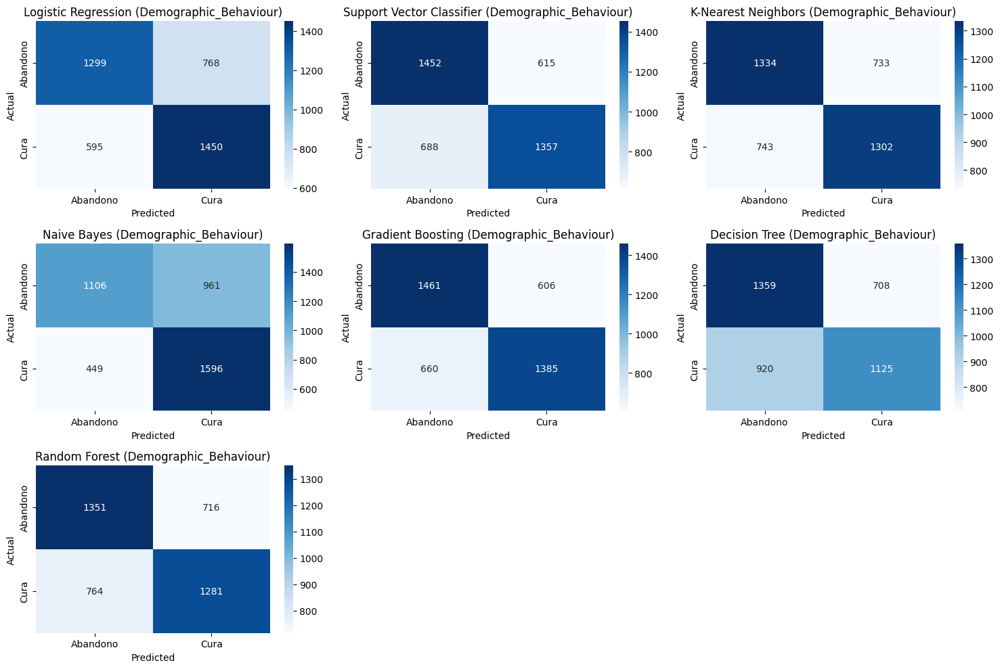

In [ ]:
# Generate and plot confusion matrices for each model based on the new demographic and behavioral feature set

# Initialize dictionary to store new confusion matrices
new_confusion_matrices = {}

# Generate confusion matrices for each model
for model_name, model in models.items():
    y_pred_new = model.predict(X_test_new)
    new_confusion_matrices[model_name] = confusion_matrix(y_test_new, y_pred_new)

# Plot confusion matrices for each model
plt.figure(figsize=(15, 10))
for i, (model_name, cm) in enumerate(new_confusion_matrices.items(), start=1):
    plt.subplot(3, 3, i)
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=target_encoder.classes_, yticklabels=target_encoder.classes_)
    plt.title(f"{model_name} (Demographic_Behaviour)")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")

plt.tight_layout()
plt.show()

In [ ]:
# Extract accuracies and F1-scores for each model
new_performance_table = pd.DataFrame({
    model_name: {
        "Accuracy": metrics["Accuracy"],
        "F1-Score (Abandono)": metrics["Classification Report"]["Abandono"]["f1-score"],
        "F1-Score (Cura)": metrics["Classification Report"]["Cura"]["f1-score"]
    } for model_name, metrics in new_model_performance.items()
}).T

new_performance_table

,Accuracy,F1-Score (Abandono),F1-Score (Cura)
Logistic Regression,0.668531,0.655895,0.680272
Support Vector Classifier,0.683123,0.690278,0.675629
K-Nearest Neighbors,0.641051,0.643822,0.638235
Naive Bayes,0.657101,0.610712,0.693611
Gradient Boosting,0.692121,0.697708,0.686323
Decision Tree,0.604086,0.625403,0.580196
Random Forest,0.640078,0.646102,0.633845


In [ ]:
!pip install lime

In [ ]:
import lime
import lime.lime_tabular
import numpy as np

# Choose a model to explain (e.g., Gradient Boosting)
model_to_explain = models["Gradient Boosting"]

# Use the dataset with 14 features that matches the model training data
explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train_new.values,  # Training data used for background distribution
    feature_names=X_train_new.columns,
    class_names=target_encoder.classes_,
    mode='classification'
)

# Select a few samples from the test set for explanation, matching feature count
samples_to_explain = X_test_new.iloc[:3]  # Explaining first 3 samples in test set
# Generate predictions for the test set
y_pred_new = model_to_explain.predict(X_test_new)

# Generate explanations with actual vs. predicted labels
for i, (sample, actual, predicted) in enumerate(zip(X_test_new.values[:3], y_test_new[:3], y_pred_new[:3])):
    actual_label = target_encoder.inverse_transform([actual])[0]
    predicted_label = target_encoder.inverse_transform([predicted])[0]

    print(f"Sample {i+1}:")
    print(f"  Actual Value: {actual_label}")
    print(f"  Predicted Value: {predicted_label}")

    # Generate LIME explanation
    explanation = explainer.explain_instance(
        sample,
        model_to_explain.predict_proba
    )
    explanation.show_in_notebook(show_table=True)

Sample 1:
  Actual Value: Cura
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  warnings.warn(


Sample 2:
  Actual Value: Abandono
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  warnings.warn(


Sample 3:
  Actual Value: Cura
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  warnings.warn(


In [ ]:
# Updating the selected columns by removing 'total_communications' and 'exposed_communication'
updated_columns = [
    'age_group', 'gender', 'race_color', 'education_level', 'occupation_type',
    'alcoholism', 'mental_condition', 'drug_addiction', 'smoking_habit',
    'communicated_disease', 'treatment_type', 'treatment_institution'
]

# Subset data based on updated selected columns and encode them for modeling
data_updated = data[updated_columns + ['current_status']]

# Encode categorical variables
for column in data_updated.select_dtypes(include=['object']).columns:
    if column != 'current_status':
        le = LabelEncoder()
        data_updated[column] = le.fit_transform(data_updated[column].astype(str))
        label_encoders[column] = le

# Encode target column
data_updated['current_status'] = target_encoder.fit_transform(data_updated['current_status'])

# Splitting data into features (X) and target (y) based on the updated selection
X_updated = data_updated.drop(columns=['current_status'])
y_updated = data_updated['current_status']

# Train-test split
X_train_updated, X_test_updated, y_train_updated, y_test_updated = train_test_split(X_updated, y_updated, test_size=0.2, random_state=42)

# Train models with the updated subset of features and evaluate
updated_model_performance = {}
updated_confusion_matrices = {}

for model_name, model in models.items():
    model.fit(X_train_updated, y_train_updated)
    y_pred_updated = model.predict(X_test_updated)
    accuracy_updated = accuracy_score(y_test_updated, y_pred_updated)
    report_updated = classification_report(y_test_updated, y_pred_updated, target_names=target_encoder.classes_, output_dict=True)
    updated_model_performance[model_name] = {"Accuracy": accuracy_updated, "Classification Report": report_updated}
    updated_confusion_matrices[model_name] = confusion_matrix(y_test_updated, y_pred_updated)

# Create an updated performance table
updated_performance_table = pd.DataFrame({
    model_name: {
        "Accuracy": metrics["Accuracy"],
        "F1-Score (Abandono)": metrics["Classification Report"]["Abandono"]["f1-score"],
        "F1-Score (Cura)": metrics["Classification Report"]["Cura"]["f1-score"]
    } for model_name, metrics in updated_model_performance.items()
}).T

updated_performance_table

<ipython-input-57-88cd1fb26c75>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_updated[column] = le.fit_transform(data_updated[column].astype(str))
<ipython-input-57-88cd1fb26c75>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_updated[column] = le.fit_transform(data_updated[column].astype(str))
<ipython-input-57-88cd1fb26c75>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats

,Accuracy,F1-Score (Abandono),F1-Score (Cura)
Logistic Regression,0.664397,0.641930,0.684211
Support Vector Classifier,0.674854,0.643752,0.700962
K-Nearest Neighbors,0.606274,0.607705,0.604833
Naive Bayes,0.640564,0.576261,0.687922
Gradient Boosting,0.678988,0.666498,0.690577
Decision Tree,0.612840,0.625940,0.598790
Random Forest,0.629621,0.630070,0.629170


In [ ]:
updated_performance_table

,Accuracy,F1-Score (Abandono),F1-Score (Cura)
Logistic Regression,0.664397,0.641930,0.684211
Support Vector Classifier,0.674854,0.643752,0.700962
K-Nearest Neighbors,0.606274,0.607705,0.604833
Naive Bayes,0.640564,0.576261,0.687922
Gradient Boosting,0.678988,0.666498,0.690577
Decision Tree,0.612840,0.625940,0.598790
Random Forest,0.629621,0.630070,0.629170


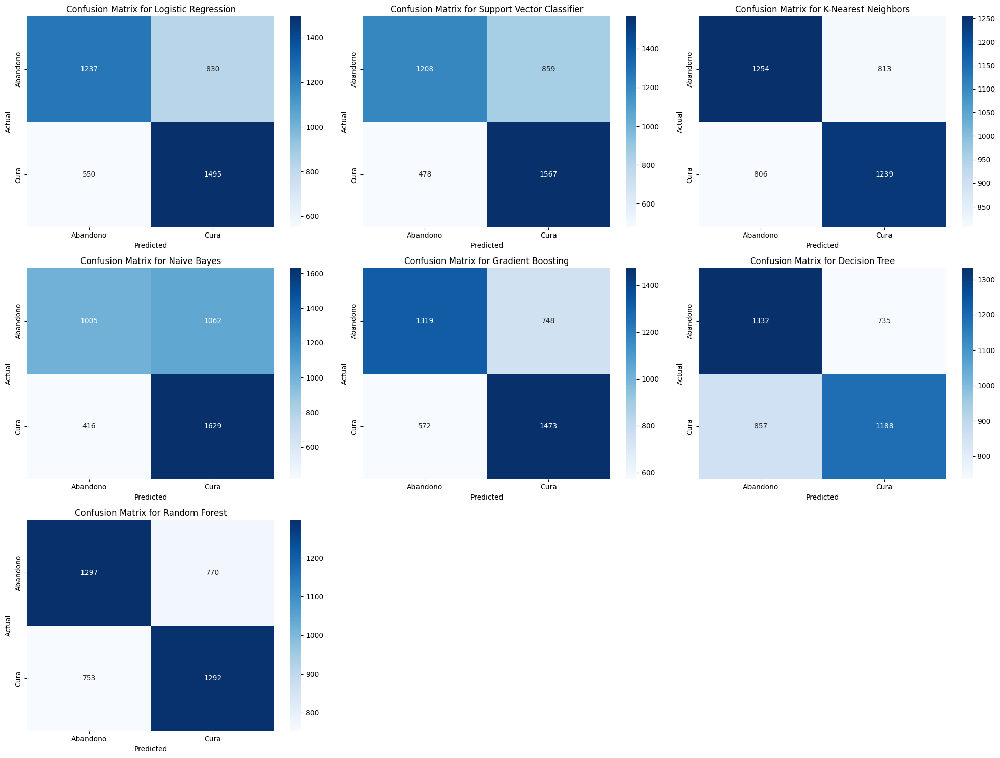

In [ ]:
# Plot confusion matrices for each model
plt.figure(figsize=(20, 15))
for i, (model_name, cm) in enumerate(updated_confusion_matrices.items(), start=1):
    plt.subplot(3, 3, i)
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=target_encoder.classes_, yticklabels=target_encoder.classes_)
    plt.title(f"Confusion Matrix for {model_name}")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")

plt.tight_layout()
plt.show()

In [ ]:
import lime
import lime.lime_tabular

# Determine the best-performing model based on accuracy
sorted_models = sorted(updated_model_performance.items(), key=lambda x: x[1]["Accuracy"], reverse=True)

# Initialize LIME explainer based on the updated features
explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train_updated.values,  # Use training data for background distribution
    feature_names=X_train_updated.columns,
    class_names=target_encoder.classes_,
    mode='classification'
)

# Number of samples to explain for each model
num_samples_to_explain = 3

# Generate explanations for each model
for model_name, metrics in sorted_models:
    model = models[model_name]
    y_pred_updated = model.predict(X_test_updated)

    print(f"\nExplaining predictions for {model_name} (Accuracy: {metrics['Accuracy']:.2f})\n")

    # Explain a few selected instances
    for i, (sample, actual, predicted) in enumerate(zip(X_test_updated.values[:num_samples_to_explain], y_test_updated[:num_samples_to_explain], y_pred_updated[:num_samples_to_explain])):
        actual_label = target_encoder.inverse_transform([actual])[0]
        predicted_label = target_encoder.inverse_transform([predicted])[0]

        print(f"Sample {i+1}:")
        print(f"  Actual Value: {actual_label}")
        print(f"  Predicted Value: {predicted_label}")

        # Generate LIME explanation
        explanation = explainer.explain_instance(
            sample,
            model.predict_proba
        )
        explanation.show_in_notebook(show_table=True)



Explaining predictions for Gradient Boosting (Accuracy: 0.68)

Sample 1:
  Actual Value: Cura
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  warnings.warn(


Sample 2:
  Actual Value: Abandono
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  warnings.warn(


Sample 3:
  Actual Value: Cura
  Predicted Value: Cura


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  warnings.warn(



Explaining predictions for Support Vector Classifier (Accuracy: 0.67)

Sample 1:
  Actual Value: Cura
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(


Sample 2:
  Actual Value: Abandono
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(


Sample 3:
  Actual Value: Cura
  Predicted Value: Cura


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(



Explaining predictions for Logistic Regression (Accuracy: 0.66)

Sample 1:
  Actual Value: Cura
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Sample 2:
  Actual Value: Abandono
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Sample 3:
  Actual Value: Cura
  Predicted Value: Cura


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(



Explaining predictions for Naive Bayes (Accuracy: 0.64)

Sample 1:
  Actual Value: Cura
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


Sample 2:
  Actual Value: Abandono
  Predicted Value: Cura


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


Sample 3:
  Actual Value: Cura
  Predicted Value: Cura


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(



Explaining predictions for Random Forest (Accuracy: 0.63)

Sample 1:
  Actual Value: Cura
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Sample 2:
  Actual Value: Abandono
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Sample 3:
  Actual Value: Cura
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(



Explaining predictions for Decision Tree (Accuracy: 0.61)

Sample 1:
  Actual Value: Cura
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


Sample 2:
  Actual Value: Abandono
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


Sample 3:
  Actual Value: Cura
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(



Explaining predictions for K-Nearest Neighbors (Accuracy: 0.61)

Sample 1:
  Actual Value: Cura
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(


Sample 2:
  Actual Value: Abandono
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(


Sample 3:
  Actual Value: Cura
  Predicted Value: Abandono


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(
